<p style="font-family: Cambria; text-align: center; font-size: 48px;"> Univariate Analysis

#### Definition: Focuses on analyzing a single variable at a time.

#### what is Univariate Analysis?
#### Purpose: To understand the variable's distribution, central tendency, and spread.

Univariate analysis is the process of analyzing each variable individually to understand its distribution, characteristics, and potential data issues. It does not examine relationships between variables. It is an essential step in Exploratory Data Analysis (EDA) and helps in identifying missing values, skewness, outliers, and class imbalance. In the Adult dataset, univariate analysis is performed on all 14 features to understand their individual behavior before proceeding to further analysis or model building.


#### What Do We Check in Univariate Analysis?

#### Numerical Variable
     Techniques: Descriptive Statistics (Min, Max, Mean, Mode, Median, Range, Standard Deviation, Quantitles, skewness)
      
     Visualizations :  Histogram, Box plot, Density Plot
      
     Examples: age, hours_per_week
     
#### Categorical Variable
     Techniques: Frequency Count, Frequency Percentage 
     
     Visualizations : Pie Chart and Bar Chart
    
     Examples: workclass, marital_status, occupation, sex

####  we analyze a single variable, this method does not explore: Relationships, Interactions, Correlations and Causes

#### Advantages:
#### 1. Simple and Easy to Understand
     It is the most basic form of analysis.

     Requires minimal statistical knowledge.

     Easy to explain to non‑technical audiences.

#### 2. Fast and Computationally Lightweight

     Works on one variable at a time.

     No complex calculations or heavy processing.

#### 3. Helps Detect Data Quality Issues Early

      Missing values, Outliers, Invalid values, skewed distribution

#### 4. Guides Feature Engineering

     Skewed variables may need transformation (log, sqrt).

     Outliers may need capping or removal.

     Categorical variables may need grouping or encoding.

#### 5. Foundation for Deeper Analysis

     Before studying relationships, you must understand each variable individually.

     Sets the stage for bivariate and multivariate analysis.


#### Disadvantages:
#### 1. Cannot Explain Relationships

      It does not show how variables interact.
      Cannot detect multicollinearity

       You cannot answer questions like:
           “Does education affect income?”  
           “Does age influence hours worked?”

#### 2. No Insight Into Causes

      It is descriptive, not explanatory.

      You cannot infer why a pattern exists.

#### 3. Limited Usefulness for Predictive Modeling

      Models rely on relationships between variables.

      Univariate analysis alone cannot build or validate a model.

#### 4. Oversimplifies Complex Data

      Real‑world datasets have interactions, correlations, and dependencies.

      Looking at one variable at a time may hide important patterns.

### Conclusion: Univariate analysis examines a single variable at a time to understand its distribution, central tendency, spread, outliers, and data quality. Because it focuses on only one variable, it cannot reveal relationships, interactions, correlations, or causes, and must be followed by bivariate and multivariate analysis for deeper insights.

In [2]:
import pandas as pd          # Data manipulation
import numpy as np           # Numerical operations

import matplotlib.pyplot as plt   # Basic plotting
import seaborn as sns             # Statistical visualizations

import plotly.express as px       # Interactive plots (histograms, bar charts)

sns.set(style="whitegrid")

In [4]:
import warnings
warnings.filterwarnings("ignore")


In [6]:


df_train_test = pd.read_csv("/Users/akhilamaheedhara/Desktop/cleaned_adult.csv") 

df_train_test.head()


,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income,income_num
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K,0
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K,0
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K,0
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K,0
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K,0


#  age
####  Variable Type:
####     Numerical (Continuous)


In [8]:
# Summary statistics

print(df_train_test['age'].describe())

# Mode
print("Mode of age:", df_train_test['age'].mode()[0])


count    48842.000000
mean        38.643585
std         13.710510
min         17.000000
25%         28.000000
50%         37.000000
75%         48.000000
max         90.000000
Name: age, dtype: float64
Mode of age: 36


#### The age distribution ranges from 17 to 90, covering a wide span of working‑age adults.

#### The average age is ~39, and the median is 37, showing a fairly balanced distribution.

#### The most common age is 36, indicating a concentration of individuals in their mid‑30s.

#### The spread (std = 13.7) shows diversity in age, with both younger and older adults represented.

#### No unrealistic values or anomalies are present.

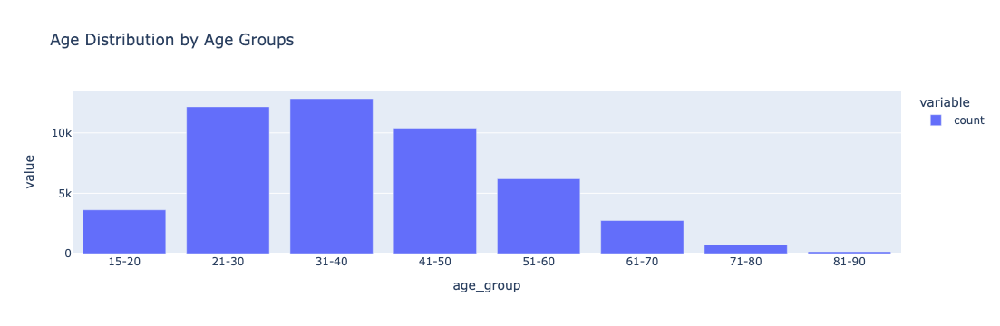

In [10]:
# Histogram
bins = [15, 20, 30, 40, 50, 60, 70, 80, 90]
labels = ['15-20','21-30','31-40','41-50','51-60','61-70','71-80','81-90']

df_train_test['age_group'] = pd.cut(df_train_test['age'], bins=bins, labels=labels, include_lowest=True)

fig = px.bar(
    df_train_test['age_group'].value_counts().sort_index(),
    title='Age Distribution by Age Groups'
)
fig.update_traces(hovertemplate='Age Group: %{x}<br>Count: %{y}')
fig.show()


#### The dataset is heavily concentrated in the 21–50 age range, with the highest representation in the 31–40 group. Both younger (15–20) and older (70+) age groups are underrepresented, indicating that the dataset primarily reflects working‑age adults.

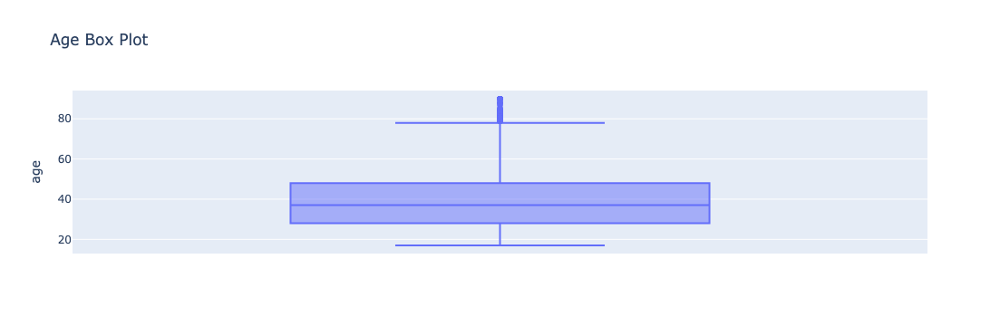

In [12]:
# Box plot
fig = px.box(df_train_test, y='age', title='Age Box Plot')
fig.show()


#### The age distribution is centered around 37 years, with most individuals between 28 and 48. The data shows a slight right skew due to older individuals (70–90), which appear as outliers. Overall, the distribution is clean, realistic, and consistent with a working‑age population.

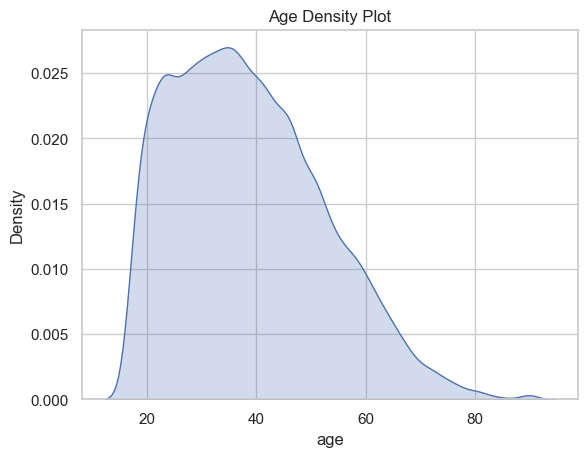

In [14]:
# Density plot
sns.kdeplot(df_train_test['age'], fill=True)
plt.title('Age Density Plot')
plt.show()


####  The age density plot shows a smooth, slightly right‑skewed distribution with the highest concentration of individuals between ages 30 and 40. Density declines steadily after age 50, with very few individuals above 70, indicating a typical working‑age population.

#### The age variable shows a clean, slightly right‑skewed distribution centered around the mid‑30s, with most individuals between 28 and 48, a mode of 36, and only a small number of older outliers.


# 2. Workclass 

####    Variable Type:
####       Categorical

In [16]:
# Descriptive summary for categorical variable
print("Unique categories:", df_train_test['workclass'].nunique())
print("\nCategory counts:\n", df_train_test['workclass'].value_counts())
print("\nCategory percentages:\n", df_train_test['workclass'].value_counts(normalize=True) * 100)
print("Mode of workclass:", df_train_test['workclass'].mode()[0])



Unique categories: 8

Category counts:
 workclass
Private             36705
Self-emp-not-inc     3862
Local-gov            3136
State-gov            1981
Self-emp-inc         1695
Federal-gov          1432
Without-pay            21
Never-worked           10
Name: count, dtype: int64

Category percentages:
 workclass
Private             75.150485
Self-emp-not-inc     7.907129
Local-gov            6.420703
State-gov            4.055935
Self-emp-inc         3.470374
Federal-gov          2.931903
Without-pay          0.042996
Never-worked         0.020474
Name: proportion, dtype: float64
Mode of workclass: Private


#### The workclass variable is heavily skewed toward Private employment (69%), with government and self‑employment categories forming small secondary groups and two extremely rare categories (Without‑pay, Never‑worked) that contribute almost nothing to the dataset.

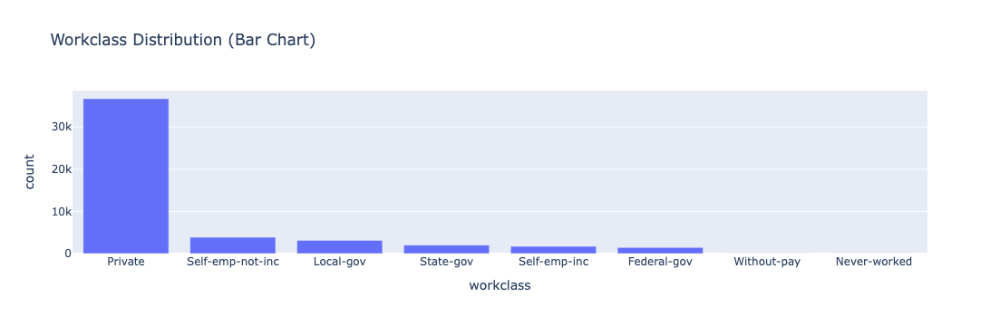

In [18]:
wc = df_train_test['workclass'].value_counts().reset_index()
wc.columns = ['workclass', 'count']

fig = px.bar(
    wc,
    x='workclass',
    y='count',
    title='Workclass Distribution (Bar Chart)'
)

fig.update_traces(hovertemplate='Workclass: %{x}<br>Count: %{y}')
fig.show()



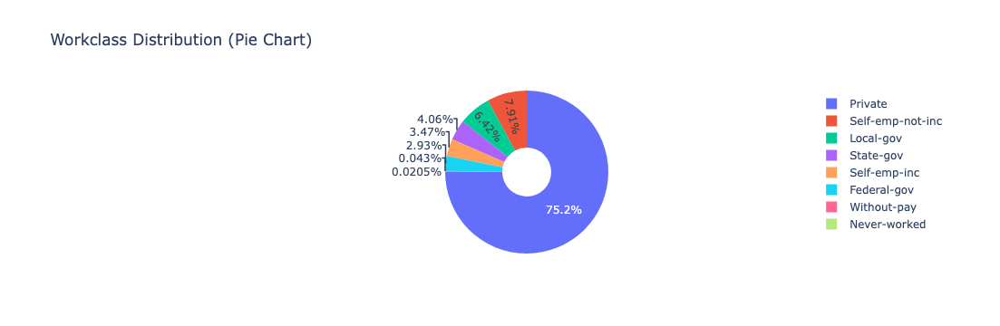

In [20]:
fig = px.pie(
    df_train_test,
    names='workclass',
    title='Workclass Distribution (Pie Chart)',
    hole=0.3  # optional donut style
)

fig.update_traces(hovertemplate='Workclass: %{label}<br>Percent: %{percent}')
fig.show()


In [22]:
df_train_test['workclass_grouped'] = df_train_test['workclass'].replace({
    'Federal-gov': 'Government',
    'State-gov': 'Government',
    'Local-gov': 'Government',
    'Self-emp-inc': 'Self-Employed',
    'Self-emp-not-inc': 'Self-Employed',
    'Without-pay': 'Not-Working',
    'Never-worked': 'Not-Working',
    'Unknown': 'Unknown',
    'Private': 'Private'
})


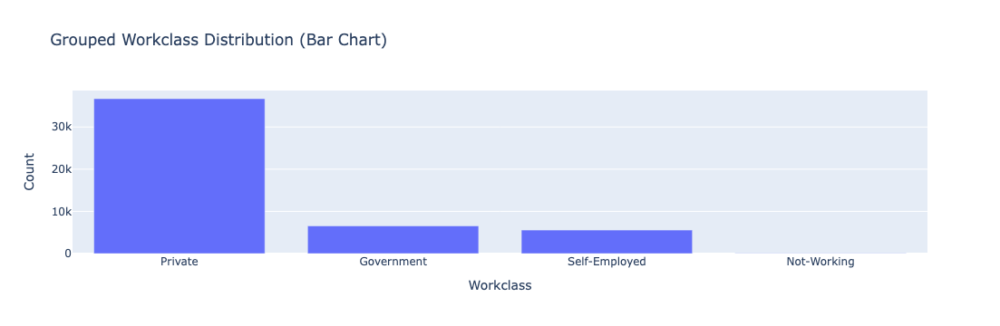

In [24]:
wc_grouped = df_train_test['workclass_grouped'].value_counts().reset_index()
wc_grouped.columns = ['workclass_grouped', 'count']

fig = px.bar(
    wc_grouped,
    x='workclass_grouped',
    y='count',
    title='Grouped Workclass Distribution (Bar Chart)',
    labels={'workclass_grouped': 'Workclass', 'count': 'Count'}
)

fig.update_traces(hovertemplate='Workclass: %{x}<br>Count: %{y}')
fig.show()


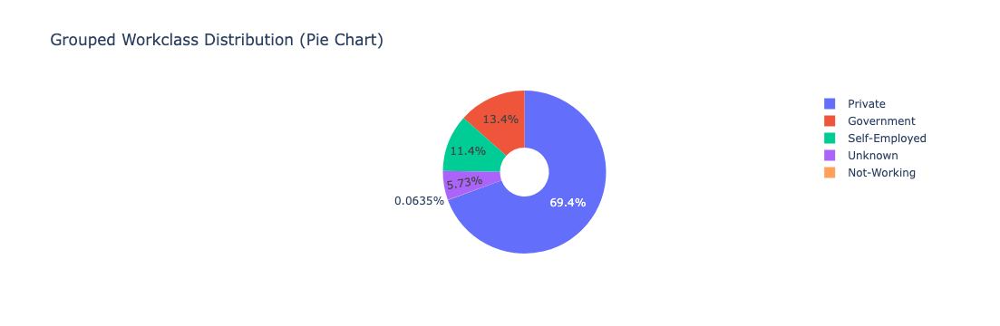

In [14]:
fig = px.pie(
    df_train_test,
    names='workclass_grouped',
    title='Grouped Workclass Distribution (Pie Chart)',
    hole=0.3
)

fig.update_traces(hovertemplate='Workclass: %{label}<br>Percent: %{percent}')
fig.show()


#### The workclass is heavily dominated by Private‑sector workers, with Government and Self‑Employed forming mid‑sized groups, while Unknown and Not‑Working categories are very small and require careful handling in analysis and modeling.

# 3. fnlwgt
#### Variable Type:
  ####   Numeric(continuous)

In [26]:
print(df_train_test['fnlwgt'].describe())
print("Mode of fnlwgt:", df_train_test['fnlwgt'].mode()[0])


count    4.884200e+04
mean     1.896641e+05
std      1.056040e+05
min      1.228500e+04
25%      1.175505e+05
50%      1.781445e+05
75%      2.376420e+05
max      1.490400e+06
Name: fnlwgt, dtype: float64
Mode of fnlwgt: 203488


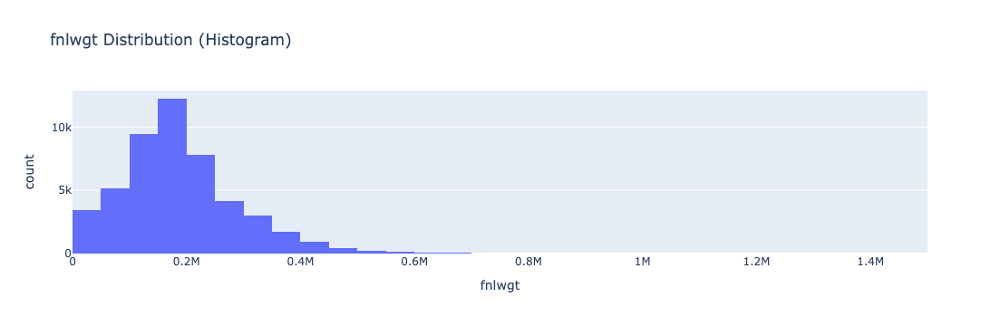

In [28]:
fig = px.histogram(
    df_train_test,
    x='fnlwgt',
    nbins=40,
    title='fnlwgt Distribution (Histogram)'
)
fig.update_traces(hovertemplate='fnlwgt: %{x}<br>Count: %{y}')
fig.show()


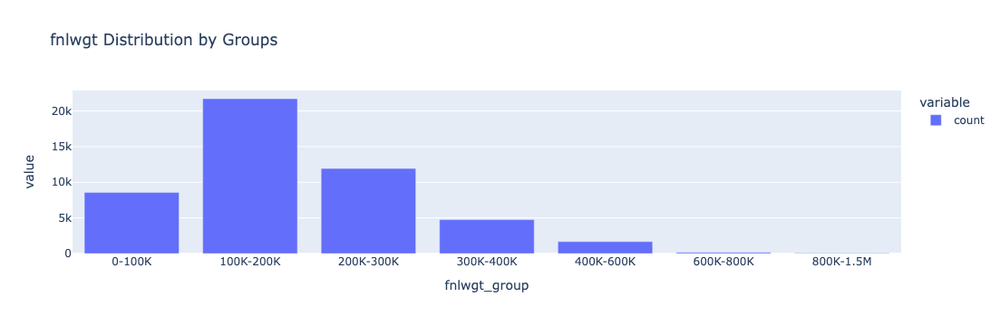

In [30]:
bins = [0, 100000, 200000, 300000, 400000, 600000, 800000, 1500000]
labels = [
    '0-100K', '100K-200K', '200K-300K', '300K-400K',
    '400K-600K', '600K-800K', '800K-1.5M'
]

df_train_test['fnlwgt_group'] = pd.cut(df_train_test['fnlwgt'], bins=bins, labels=labels, include_lowest=True)

fig = px.bar(
    df_train_test['fnlwgt_group'].value_counts().sort_index(),
    title='fnlwgt Distribution by Groups'
)
fig.update_traces(hovertemplate='Group: %{x}<br>Count: %{y}')
fig.show()


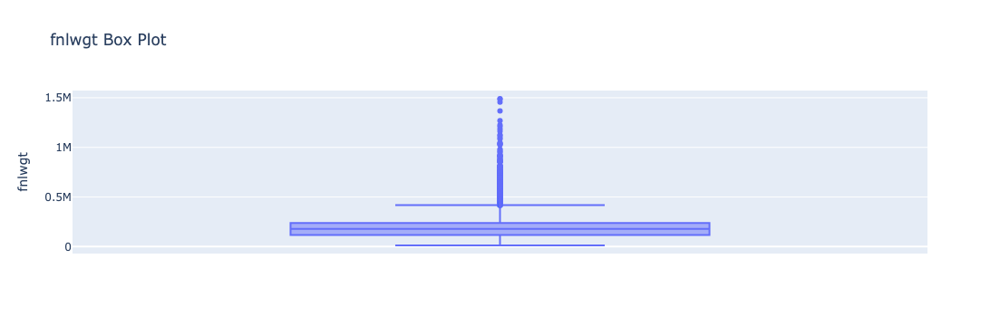

In [32]:
fig = px.box(
    df_train_test,
    y='fnlwgt',
    title='fnlwgt Box Plot'
)
fig.update_traces(hovertemplate='fnlwgt: %{y}')
fig.show()


#### The fnlwgt variable shows a strongly right‑skewed distribution, where most individuals fall within moderate weight ranges and a small portion carry exceptionally large sampling weights. The majority of values cluster between 100K and 300K, with frequencies dropping sharply as the weight increases. This pattern reveals substantial high‑end outliers and an uneven spread, suggesting that fnlwgt may need transformation, binning, or careful handling during modeling.

# 4. Education
#### Variable Type:
#### Categorical


In [34]:
print("Unique categories:", df_train_test['education'].nunique())
print("\nCategory counts:\n", df_train_test['education'].value_counts())
print("\nCategory percentages:\n", df_train_test['education'].value_counts(normalize=True) * 100)


Unique categories: 16

Category counts:
 education
HS-grad         15784
Some-college    10878
Bachelors        8025
Masters          2657
Assoc-voc        2061
11th             1812
Assoc-acdm       1601
10th             1389
7th-8th           955
Prof-school       834
9th               756
12th              657
Doctorate         594
5th-6th           509
1st-4th           247
Preschool          83
Name: count, dtype: int64

Category percentages:
 education
HS-grad         32.316449
Some-college    22.271815
Bachelors       16.430531
Masters          5.439990
Assoc-voc        4.219729
11th             3.709922
Assoc-acdm       3.277917
10th             2.843864
7th-8th          1.955284
Prof-school      1.707547
9th              1.547848
12th             1.345154
Doctorate        1.216166
5th-6th          1.042136
1st-4th          0.505712
Preschool        0.169936
Name: proportion, dtype: float64


In [36]:
print("Mode of education:", df_train_test['education'].mode()[0])


Mode of education: HS-grad


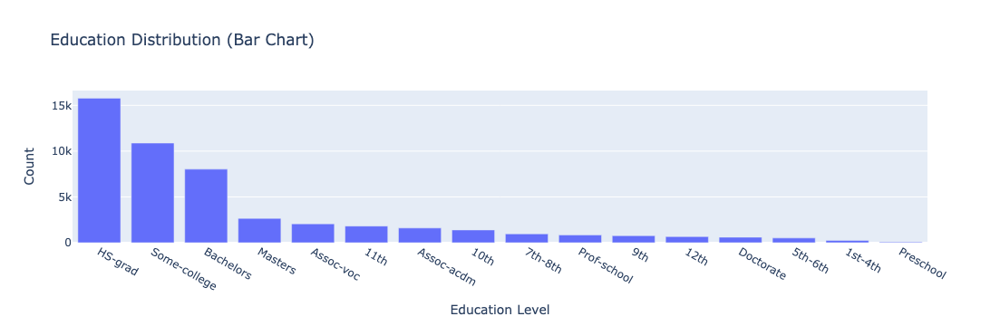

In [38]:
edu = df_train_test['education'].value_counts().reset_index()
edu.columns = ['education', 'count']

fig = px.bar(
    edu,
    x='education',
    y='count',
    title='Education Distribution (Bar Chart)',
    labels={'education': 'Education Level', 'count': 'Count'}
)

fig.update_traces(hovertemplate='Education: %{x}<br>Count: %{y}')
fig.show()


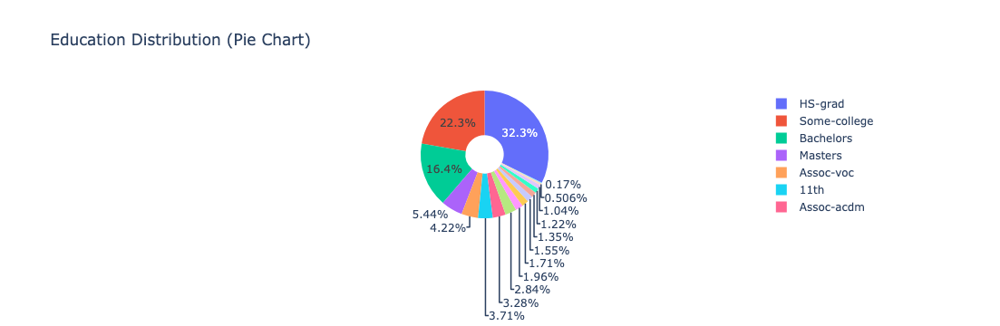

In [40]:
fig = px.pie(
    df_train_test,
    names='education',
    title='Education Distribution (Pie Chart)',
    hole=0.3
)

fig.update_traces(hovertemplate='Education: %{label}<br>Percent: %{percent}')
fig.show()


In [42]:
df_train_test['education_grouped'] = df_train_test['education'].replace({
    'Preschool': 'Lower-Education',
    '1st-4th': 'Lower-Education',
    '5th-6th': 'Lower-Education',
    '7th-8th': 'Lower-Education',
    '9th': 'Lower-Education',
    '10th': 'Lower-Education',
    '11th': 'Lower-Education',
    '12th': 'Lower-Education',
    'HS-grad': 'High-School',
    'Some-college': 'Some-College',
    'Assoc-acdm': 'Associates',
    'Assoc-voc': 'Associates',
    'Bachelors': 'Bachelors',
    'Masters': 'Advanced-Degree',
    'Doctorate': 'Advanced-Degree',
    'Prof-school': 'Advanced-Degree'
})


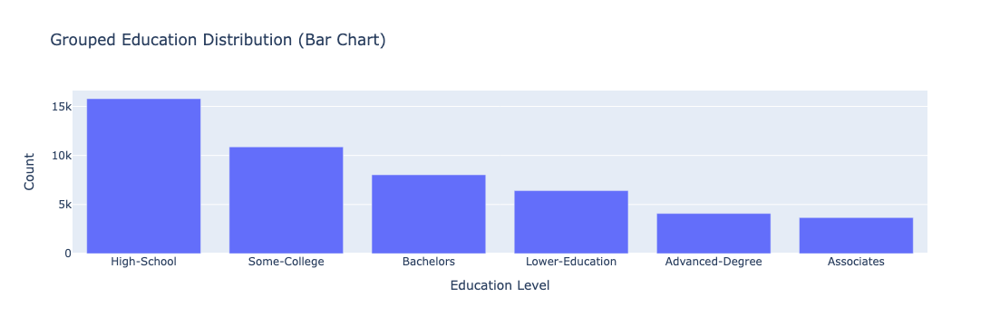

In [44]:
edu_grouped = df_train_test['education_grouped'].value_counts().reset_index()
edu_grouped.columns = ['education_grouped', 'count']

fig = px.bar(
    edu_grouped,
    x='education_grouped',
    y='count',
    title='Grouped Education Distribution (Bar Chart)',
    labels={'education_grouped': 'Education Level', 'count': 'Count'}
)

fig.update_traces(hovertemplate='Education: %{x}<br>Count: %{y}')
fig.show()


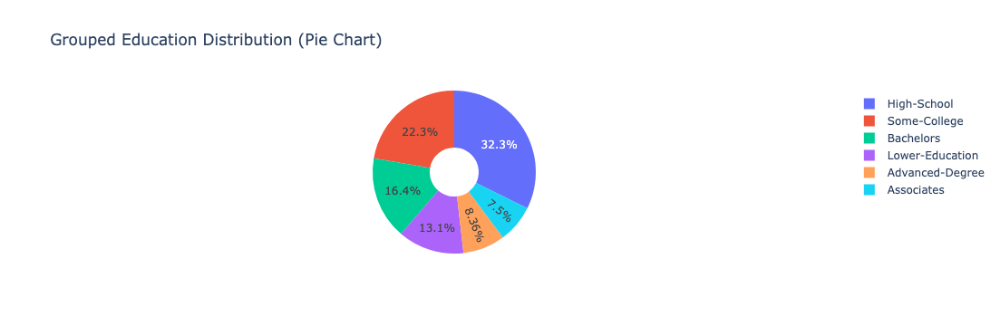

In [46]:
fig = px.pie(
    df_train_test,
    names='education_grouped',
    title='Grouped Education Distribution (Pie Chart)',
    hole=0.3
)

fig.update_traces(hovertemplate='Education: %{label}<br>Percent: %{percent}')
fig.show()


#### The distribution of education levels shows that most individuals fall into mid‑level categories, with High‑School being the largest group, followed by Some‑College and Bachelors. Lower‑Education and Advanced‑Degree groups appear in moderate numbers, while Associates is the smallest category. This pattern reflects a population where basic and intermediate education levels dominate, and higher academic qualifications are comparatively less common.

#  5. Education_num
#### Variable Type:
#### ordinal

In [67]:
print(df_train_test['education-num'].describe())


count    48842.000000
mean        10.078089
std          2.570973
min          1.000000
25%          9.000000
50%         10.000000
75%         12.000000
max         16.000000
Name: education-num, dtype: float64


In [71]:
print("Mode of education-num:", df_train_test['education-num'].mode()[0])


Mode of education-num: 9


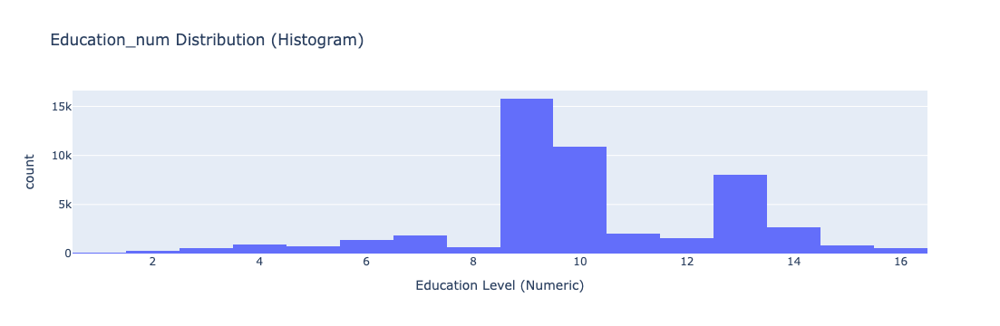

In [73]:
fig = px.histogram(
    df_train_test,
    x='education-num',
    nbins=16,
    title='Education_num Distribution (Histogram)',
    labels={'education-num': 'Education Level (Numeric)'}
)

fig.update_traces(hovertemplate='Education_num: %{x}<br>Count: %{y}')
fig.show()


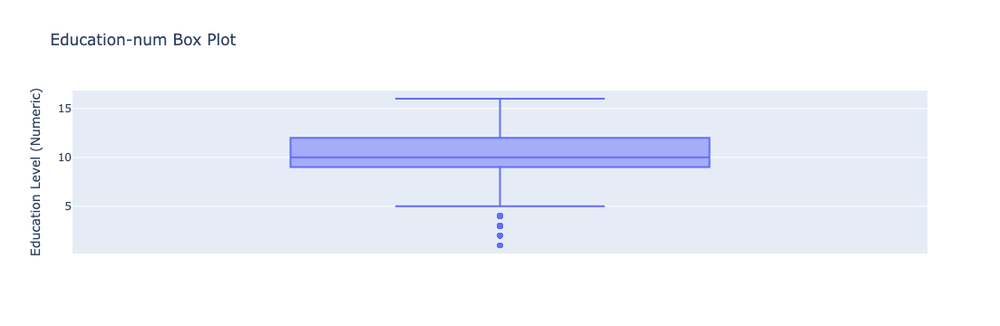

In [75]:
fig = px.box(
    df_train_test,
    y='education-num',
    title='Education-num Box Plot',
    labels={'education-num': 'Education Level (Numeric)'}
)

fig.update_traces(hovertemplate='Education-num: %{y}')
fig.show()


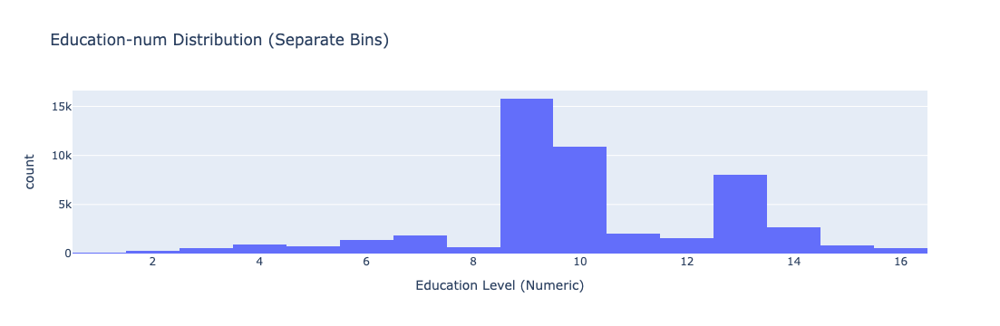

In [77]:
fig = px.histogram(
    df_train_test,
    x='education-num',
    nbins=16,
    title='Education-num Distribution (Separate Bins)',
    labels={'education-num': 'Education Level (Numeric)'}
)

fig.update_traces(hovertemplate='Education-num: %{x}<br>Count: %{y}')
fig.show()


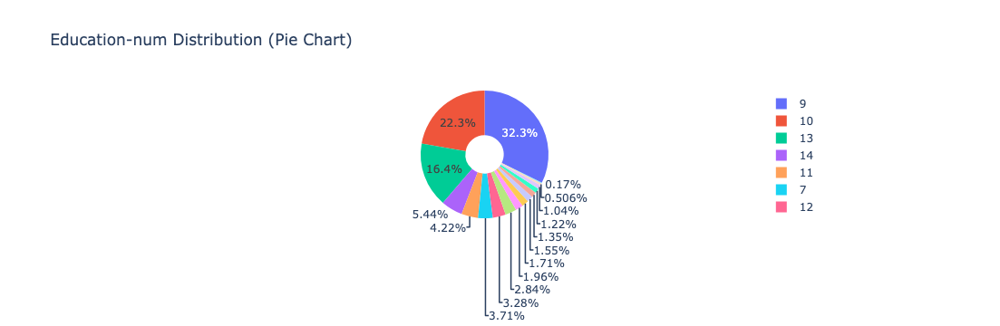

In [79]:
fig = px.pie(
    df_train_test,
    names='education-num',
    title='Education-num Distribution (Pie Chart)',
    hole=0.3
)

fig.update_traces(hovertemplate='Education-num: %{label}<br>Percent: %{percent}')
fig.show()


In [81]:
df_train_test['education_num_grouped'] = pd.cut(
    df_train_test['education-num'],
    bins=[0, 8, 9, 10, 12, 13, 16],
    labels=[
        'Lower-Education',   # 1–8
        'High-School',       # 9
        'Some-College',      # 10
        'Associates',        # 11–12
        'Bachelors',         # 13
        'Advanced-Degree'    # 14–16
    ],
    include_lowest=True
)


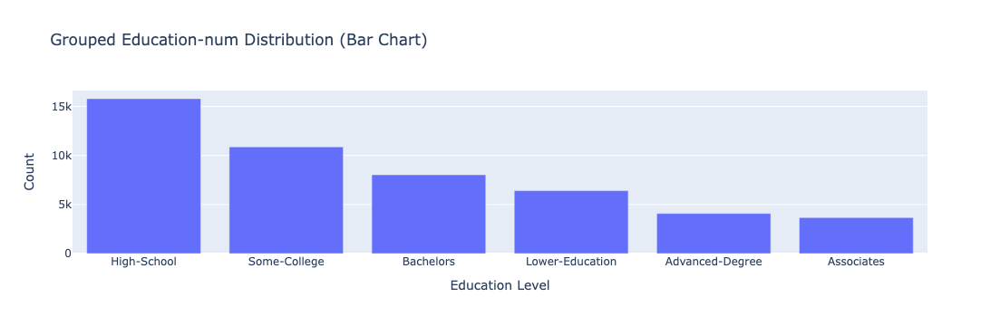

In [83]:
edu_grp = df_train_test['education_num_grouped'].value_counts().reset_index()
edu_grp.columns = ['education_grouped', 'count']

fig = px.bar(
    edu_grp,
    x='education_grouped',
    y='count',
    title='Grouped Education-num Distribution (Bar Chart)',
    labels={'education_grouped': 'Education Level', 'count': 'Count'}
)

fig.update_traces(hovertemplate='Education: %{x}<br>Count: %{y}')
fig.show()


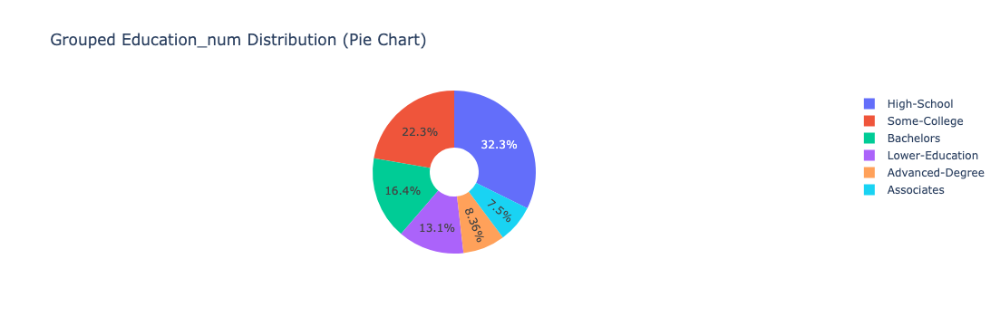

In [85]:
fig = px.pie(
    df_train_test,
    names='education_num_grouped',
    title='Grouped Education_num Distribution (Pie Chart)',
    hole=0.3
)

fig.update_traces(hovertemplate='Education: %{label}<br>Percent: %{percent}')
fig.show()


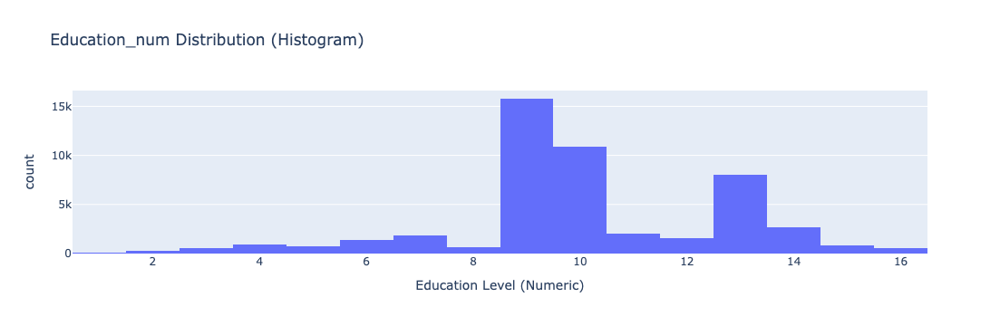

In [35]:
fig = px.histogram(
    df_train_test,
    x='education_num',
    nbins=16,
    title='Education_num Distribution (Histogram)',
    labels={'education_num': 'Education Level (Numeric)'}
)

fig.update_traces(hovertemplate='Education_num: %{x}<br>Count: %{y}')
fig.show()


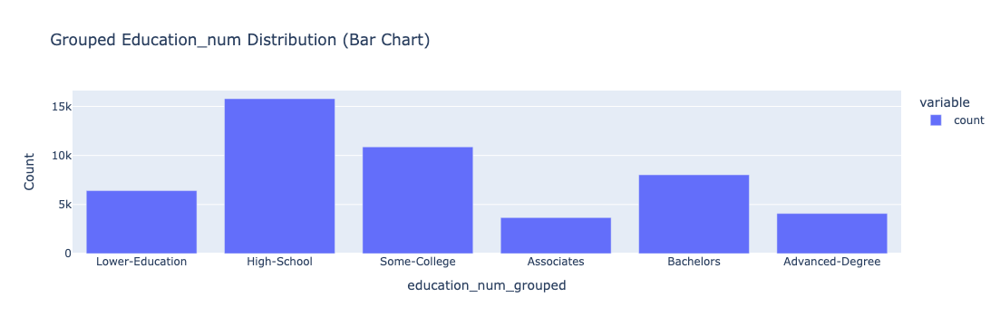

In [87]:
fig = px.bar(
    df_train_test['education_num_grouped'].value_counts().sort_index(),
    title='Grouped Education_num Distribution (Bar Chart)',
    labels={'index': 'Education Group', 'value': 'Count'}
)

fig.show()


#### The distribution of education levels shows that most individuals fall into mid‑level categories, with High‑School and Some‑College forming the largest portions of the population. Bachelors also represents a substantial share, while Lower‑Education and Advanced‑Degree groups appear in smaller but meaningful proportions. Associates is the least represented category, indicating that intermediate vocational or academic associate programs are less common in this dataset. Overall, the pattern reflects a population where basic and intermediate education levels dominate, and higher academic attainment is comparatively less frequent.

In [37]:
# Analysis of Capital_gain 

In [91]:
df_train_test['capital-gain'].describe()

count    48842.000000
mean      1079.067626
std       7452.019058
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max      99999.000000
Name: capital-gain, dtype: float64

In [93]:
df_train_test['capital-gain'].skew()

11.894658996587948

<span style="color: blue;"><b> The distribution is heavily right‑skewed </b></span>

In [95]:
# Percentage of zero values (important for gain & loss)
zero_percent = (df_train_test['capital-gain'] == 0).mean() * 100
print(f" % of capital_gain zero values: {zero_percent:.2f}%")

 % of capital_gain zero values: 91.74%


In [97]:
(df_train_test['capital-gain'] == 0).mean()   # proportion of zeros

0.9173866754023177

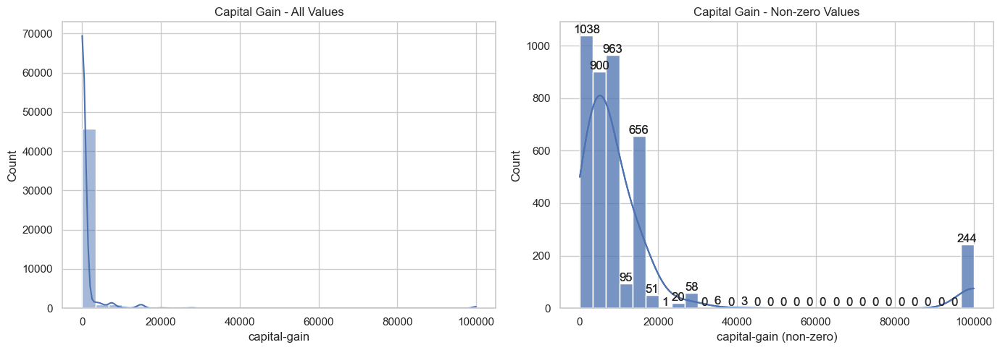

In [99]:
# 2 histogram one for all data and another for non-zero data

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# 1) All data
sns.histplot(df_train_test['capital-gain'], bins=30, kde=True, ax=axes[0], color='#4c72b0')
axes[0].set_title('Capital Gain - All Values')
axes[0].set_xlabel('capital-gain')
axes[0].set_ylabel('Count')

# 2) Non-zero capital gain
non_zero_gain = df_train_test[df_train_test['capital-gain'] > 0]['capital-gain']
ax = sns.histplot(non_zero_gain, bins=30, kde=True, ax=axes[1], color='#4c72b0')
sns.histplot(non_zero_gain, bins=30, kde=True, ax=axes[1])
axes[1].set_title('Capital Gain - Non-zero Values')
axes[1].set_xlabel('capital-gain (non-zero)')
axes[1].set_ylabel('Count')

# Add counts on top of each bar
for container in ax.containers:
    ax.bar_label(container)          # or ax.bar_label(container, fmt='%d')
    
plt.tight_layout()
plt.show()

<span style="color: blue;"><b> Capital gains are zero for the majority of individuals.
Among positive capital gains, amounts are dispersed with a few very large values, indicating an extremely right‑skewed distribution.</b></span>

# Analysis of capital loss

In [103]:
df_train_test['capital-loss'].describe()

count    48842.000000
mean        87.502314
std        403.004552
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max       4356.000000
Name: capital-loss, dtype: float64

In [105]:
df_train_test['capital-loss'].skew()

4.569808857738483

In [107]:
# Percentage of zero values (important for gain & loss)
zero_percent = (df_train_test['capital-loss'] == 0).mean() * 100
print(f" % of capital_loss zero values: {zero_percent:.2f}%")

 % of capital_loss zero values: 95.33%


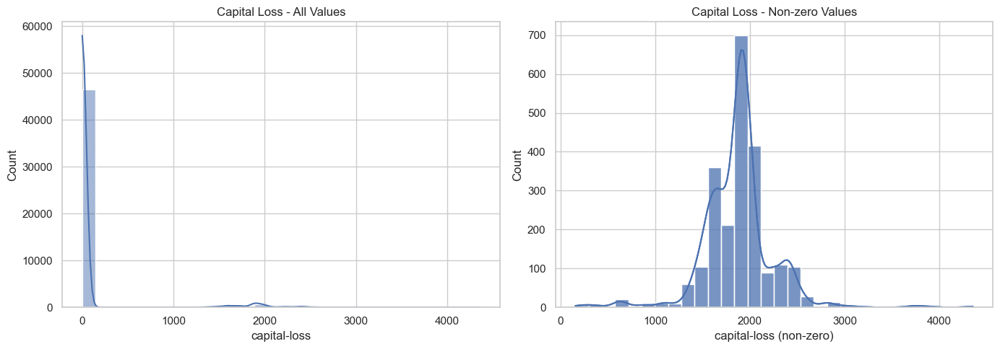

In [109]:
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# All values
sns.histplot(df_train_test['capital-loss'], bins=30, kde=True, ax=axes[0], color='#4c72b0')
axes[0].set_title('Capital Loss - All Values')
axes[0].set_xlabel('capital-loss')
axes[0].set_ylabel('Count')

# Non‑zero values
non_zero_gain = df_train_test[df_train_test['capital-loss'] > 0]['capital-loss']
ax = sns.histplot(non_zero_gain, bins=30, kde=True, ax=axes[1], color='#4c72b0')
sns.histplot(non_zero_gain, bins=30, kde=True, ax=axes[1])
axes[1].set_title('Capital Loss - Non-zero Values')
axes[1].set_xlabel('capital-loss (non-zero)')
axes[1].set_ylabel('Count')

plt.tight_layout()
plt.show()

<span style="color: blue;"><b> Capital loss is zero for 95.33% of individuals, Positive losses show a right-skewed distribution with peak around 2000 and a maximum of 4356, though much less extreme than capital gains.</b></span>

# Hours Per week Analysis

In [113]:
df_train_test['hours-per-week'].describe()

count    48842.000000
mean        40.422382
std         12.391444
min          1.000000
25%         40.000000
50%         40.000000
75%         45.000000
max         99.000000
Name: hours-per-week, dtype: float64

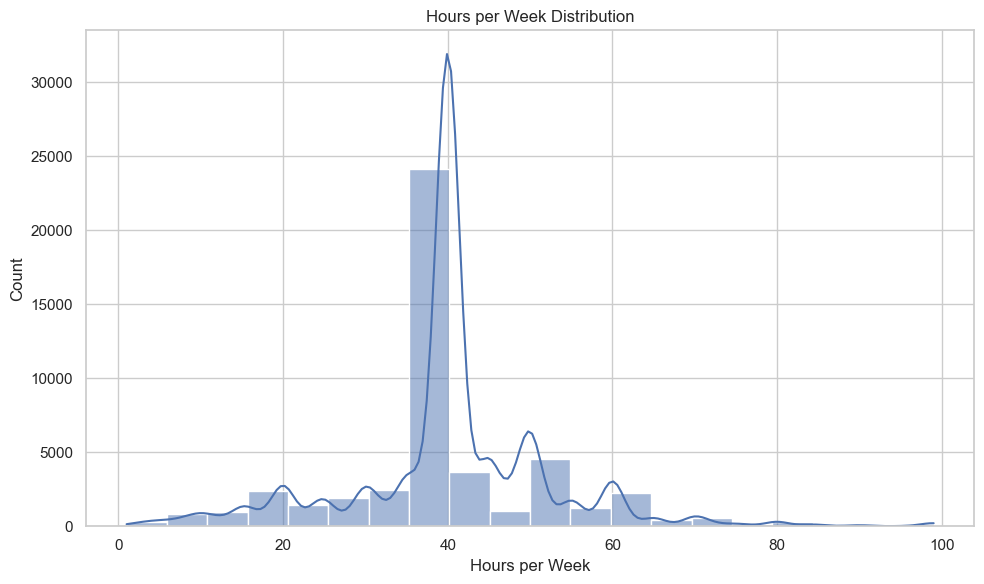

In [115]:
fig, ax = plt.subplots(1, 1, figsize=(10, 6))  # Single subplot

# Full distribution
sns.histplot(df_train_test['hours-per-week'], bins=20,  kde=True, color='#4c72b0', ax=ax)
ax.set_title('Hours per Week Distribution')
ax.set_xlabel('Hours per Week')
ax.set_ylabel('Count')

plt.tight_layout()
plt.show()


<span style="color: blue;">
Distribution centers tightly around standard 40-hour workweek (mean 40.4, median 40), with a peak at exactly 40 hours.
</span>
<span style="color: blue;">Clear right skew shows most work full-time hours, with smaller tails of part-time (<30) and overtime (>60) workers.</span>

# Native Country Analysis

In [117]:
# Cell 1: Basic exploration
print("Unique countries:", df_train_test['native-country'].nunique())
print("\nTop 10 countries:")
print(df_train_test['native-country'].value_counts().head(10))

Unique countries: 41

Top 10 countries:
native-country
United-States    44689
Mexico             951
Philippines        295
Germany            206
Puerto-Rico        184
Canada             182
El-Salvador        155
India              151
Cuba               138
England            127
Name: count, dtype: int64


In [119]:
# Frequency table
country_counts = df_train_test['native-country'].value_counts()

print("Frequency Distribution:")
print(country_counts)

Frequency Distribution:
native-country
United-States                 44689
Mexico                          951
Philippines                     295
Germany                         206
Puerto-Rico                     184
Canada                          182
El-Salvador                     155
India                           151
Cuba                            138
England                         127
China                           122
South                           115
Jamaica                         106
Italy                           105
Dominican-Republic              103
Japan                            92
Guatemala                        88
Poland                           87
Vietnam                          86
Columbia                         85
Haiti                            75
Portugal                         67
Taiwan                           65
Iran                             59
Greece                           49
Nicaragua                        49
Peru                     

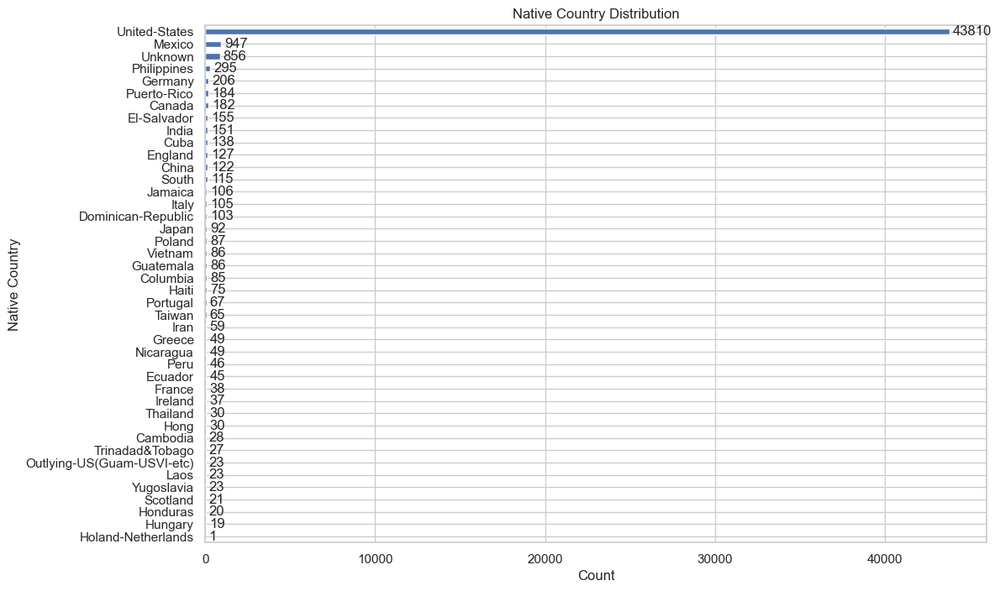

In [51]:
plt.figure(figsize=(12,8))

ax = country_counts.plot(kind='barh')

plt.title("Native Country Distribution")
plt.xlabel("Count")
plt.ylabel("Native Country")

plt.gca().invert_yaxis()  # Highest values at top

# Add value labels correctly
for container in ax.containers:
    ax.bar_label(container, fmt='%d', padding=3)
plt.show()

<span style="color: blue;">The native_country variable is highly imbalanced, with the majority of individuals originating from the United-States, while other countries have very low representation.</span>

#### Marital Status

In [121]:
print("Unique categories:", df_train_test['marital-status'].nunique())
print("\nCategory counts:\n", df_train_test['marital-status'].value_counts())
print("\nCategory percentages:\n", df_train_test['marital-status'].value_counts(normalize=True) * 100)

Unique categories: 7

Category counts:
 marital-status
Married-civ-spouse       22379
Never-married            16117
Divorced                  6633
Separated                 1530
Widowed                   1518
Married-spouse-absent      628
Married-AF-spouse           37
Name: count, dtype: int64

Category percentages:
 marital-status
Married-civ-spouse       45.819172
Never-married            32.998239
Divorced                 13.580525
Separated                 3.132550
Widowed                   3.107981
Married-spouse-absent     1.285779
Married-AF-spouse         0.075754
Name: proportion, dtype: float64


#### The dataset is dominated by individuals who are either currently married or never married.Together, these two categories account for ~79% of all observations.Divorce, separation, and widowhood form a moderate secondary cluster

### Distribution of Marital Status

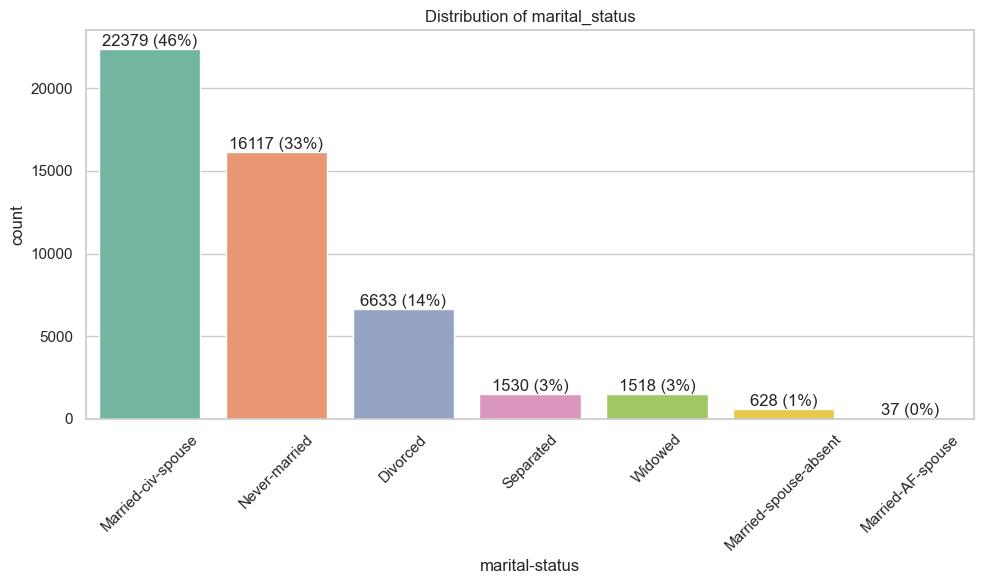

In [123]:
import warnings
warnings.filterwarnings("ignore")
col = "marital-status"

plt.figure(figsize=(10,6))
ax = sns.countplot(data=df_train_test, x=col, order=df_train_test[col].value_counts().index, palette="Set2")
plt.title("Distribution of marital_status")
plt.xticks(rotation=45)

total = len(df_train_test[col])

# Add count + percentage labels
for p in ax.patches:
    count = int(p.get_height())
    percent = (count / total) * 100
    ax.annotate(
        f'{count} ({percent:.0f}%)',
        (p.get_x() + p.get_width() / 2, p.get_height()),
        ha='center', va='bottom'
    )

plt.tight_layout()
plt.show()


#### Strong Skew Toward Married Individuals, Never-Married Is the Only Other large Group. Imbalance is significant — any model using marital status will be heavily influenced by the Married-civ-spouse group.Small categories may need grouping or special handling requires in analysis and modeling.

#### Occupation

In [125]:
col = "occupation"

# Frequency tables
counts = df_train_test[col].value_counts()
print(counts)
print("\nProportions:")
print(df_train_test[col].value_counts(normalize=True))

occupation
Prof-specialty       8981
Craft-repair         6112
Exec-managerial      6086
Adm-clerical         5611
Sales                5504
Other-service        4923
Machine-op-inspct    3022
Transport-moving     2355
Handlers-cleaners    2072
Farming-fishing      1490
Tech-support         1446
Protective-serv       983
Priv-house-serv       242
Armed-Forces           15
Name: count, dtype: int64

Proportions:
occupation
Prof-specialty       0.183879
Craft-repair         0.125138
Exec-managerial      0.124606
Adm-clerical         0.114881
Sales                0.112690
Other-service        0.100794
Machine-op-inspct    0.061873
Transport-moving     0.048217
Handlers-cleaners    0.042423
Farming-fishing      0.030507
Tech-support         0.029606
Protective-serv      0.020126
Priv-house-serv      0.004955
Armed-Forces         0.000307
Name: proportion, dtype: float64


#### The occupation variable has three nearly equal leading categories, making it more balanced.Prof-specialty,Craft-repair, Exec-managerial together, they are 37% of all individuals.

### Distribution of Occupation

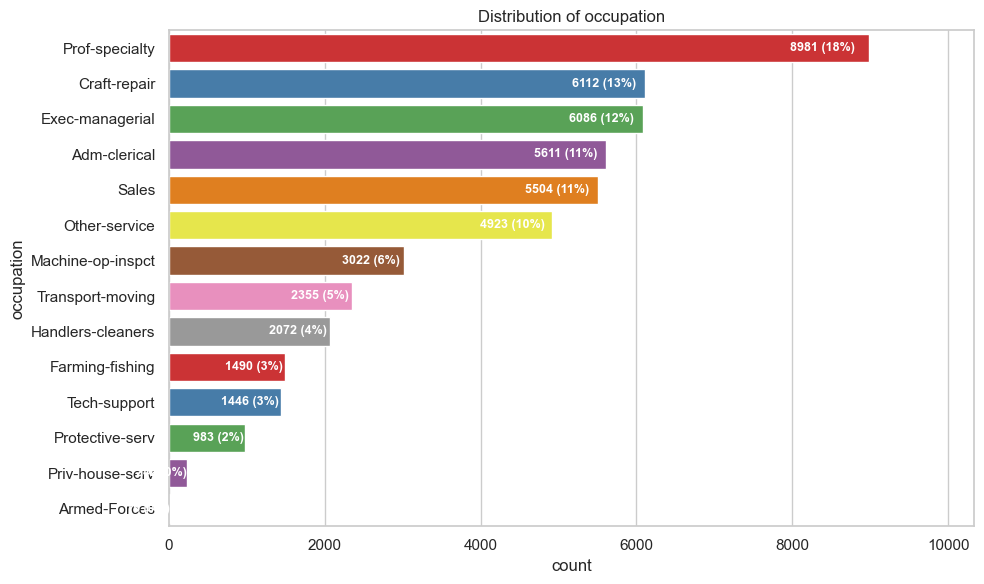

In [127]:

plt.figure(figsize=(10,6))
ax = sns.countplot(
    data=df_train_test,
    y=col,
    order=counts.index,
    palette="Set1"
)
plt.title("Distribution of occupation")

total = len(df_train_test[col])
max_count = counts.max()

# Expand x‑axis so labels fit comfortably
plt.xlim(0, max_count * 1.15)

# Add count + percentage labels INSIDE the bar
for p in ax.patches:
    count = int(p.get_width())
    percent = (count / total) * 100

    # Position text slightly before the end of the bar
    ax.annotate(
        f'{count} ({percent:.0f}%)',
        (count * 0.98, p.get_y() + p.get_height() / 2),
        ha='right', va='center', color='white', fontsize=9, fontweight='bold'
    )

plt.tight_layout()
plt.show()

In [129]:


# Define occupation clusters
occupation_clusters = {
    # Professional / Managerial
    'Prof-specialty': 'Professional/Managerial',
    'Exec-managerial': 'Professional/Managerial',
    'Tech-support': 'Professional/Managerial',

    # Administrative / Sales / Service
    'Adm-clerical': 'Admin/Sales/Service',
    'Sales': 'Admin/Sales/Service',
    'Other-service': 'Admin/Sales/Service',
    'Priv-house-serv': 'Admin/Sales/Service',

    # Skilled Trades / Manual Labor
    'Craft-repair': 'Skilled/Manual',
    'Machine-op-inspct': 'Skilled/Manual',
    'Transport-moving': 'Skilled/Manual',
    'Handlers-cleaners': 'Skilled/Manual',

    # Agriculture
    'Farming-fishing': 'Agriculture',

    # Protective / Military
    'Protective-serv': 'Protective/Military',
    'Armed-Forces': 'Protective/Military',

    # Unknown
    'Unknown': 'Unknown'
}

# Map to new column
df_train_test['occupation_cluster'] = df_train_test['occupation'].map(occupation_clusters)

# If any occupation is missing from the dictionary, fill with "Other"
df_train_test['occupation_cluster'] = df_train_test['occupation_cluster'].fillna('Other')

df_train_test['occupation_cluster'].value_counts()


occupation_cluster
Professional/Managerial    16513
Admin/Sales/Service        16280
Skilled/Manual             13561
Agriculture                 1490
Protective/Military          998
Name: count, dtype: int64

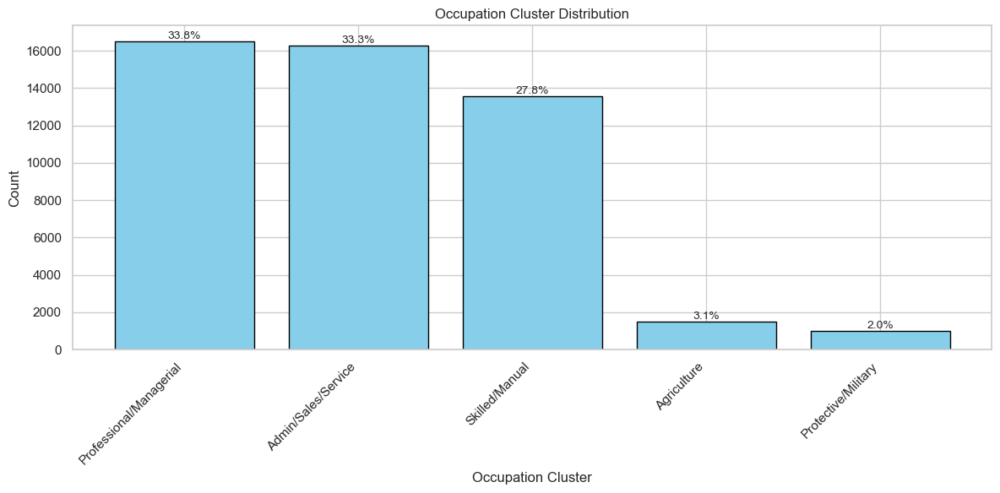

In [131]:


# Cluster names and counts
clusters = [
    'Professional/Managerial',
    'Admin/Sales/Service',
    'Skilled/Manual',
    'Agriculture',
    'Protective/Military',
    'Unknown'
]

cluster_counts = df_train_test['occupation_cluster'].value_counts()
cluster_props = df_train_test['occupation_cluster'].value_counts(normalize=True) * 100
# Plot
plt.figure(figsize=(12, 6))
bars= plt.bar(cluster_props.index,cluster_counts, color='skyblue', edgecolor='black')

plt.title('Occupation Cluster Distribution')
plt.xlabel('Occupation Cluster')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')

# Add percentage labels on bars 
for bar, pct in zip(bars, cluster_props.values): 
    height = bar.get_height() 
    plt.text( 
        bar.get_x() + bar.get_width() / 2, 
        height + 0.5, 
        f"{pct:.1f}%", ha='center', va='bottom', fontsize=10 )

plt.tight_layout()
plt.show()


#### Admin/Sales/Service is the largest cluster, with over 16,000 individuals=34%, Professional/Managerial and Skilled/Manual follow closely, each with 13–14k individuals, Agriculture, Protective/Military, and Unknown form the smaller clusters, with counts ranging from 998 to 2,809. 

#### Sex

In [133]:
col = "sex"

counts = df_train_test[col].value_counts()
total = len(df_train_test[col])

print(counts)
print("\nProportions:")
print(df_train_test[col].value_counts(normalize=True))

sex
Male      32650
Female    16192
Name: count, dtype: int64

Proportions:
sex
Male      0.668482
Female    0.331518
Name: proportion, dtype: float64


#### In the dataset, there are over twice as many males as females. That is about two‑thirds of the dataset is male and one‑third is female

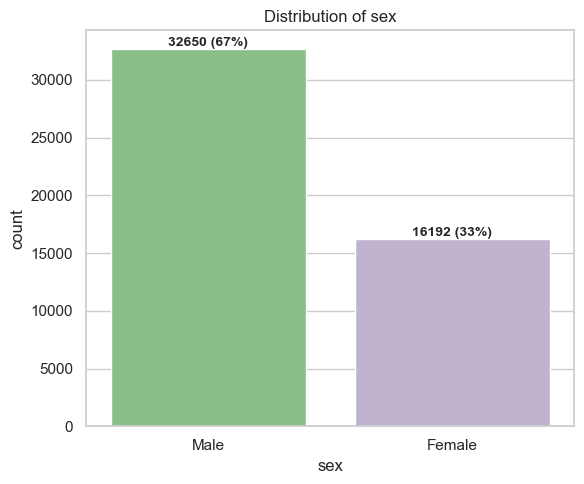

In [135]:

plt.figure(figsize=(6,5))
ax = sns.countplot(
    data=df_train_test,
    x=col,
    order=counts.index,
    palette="Accent"
)
plt.title("Distribution of sex")

# Add count + percentage labels above bars
for p in ax.patches:
    count = int(p.get_height())
    percent = (count / total) * 100

    ax.annotate(
        f'{count} ({percent:.0f}%)',
        (p.get_x() + p.get_width() / 2, count),
        ha='center', va='bottom',
        fontsize=10, fontweight='bold'
    )

plt.tight_layout()
plt.show()


#### The dataset is male‑dominant, with males representing nearly double the number of females.This imbalance may influence any analysis or modeling involving sex as a feature.

#### Relationship

In [137]:
col = "relationship"

counts = df_train_test[col].value_counts()
total = len(df_train_test[col])
max_count = counts.max()

print(counts)
print("\nProportions:")
print(df_train_test[col].value_counts(normalize=True))

relationship
Husband           19716
Not-in-family     12583
Own-child          7581
Unmarried          5125
Wife               2331
Other-relative     1506
Name: count, dtype: int64

Proportions:
relationship
Husband           0.403669
Not-in-family     0.257627
Own-child         0.155215
Unmarried         0.104930
Wife              0.047725
Other-relative    0.030834
Name: proportion, dtype: float64


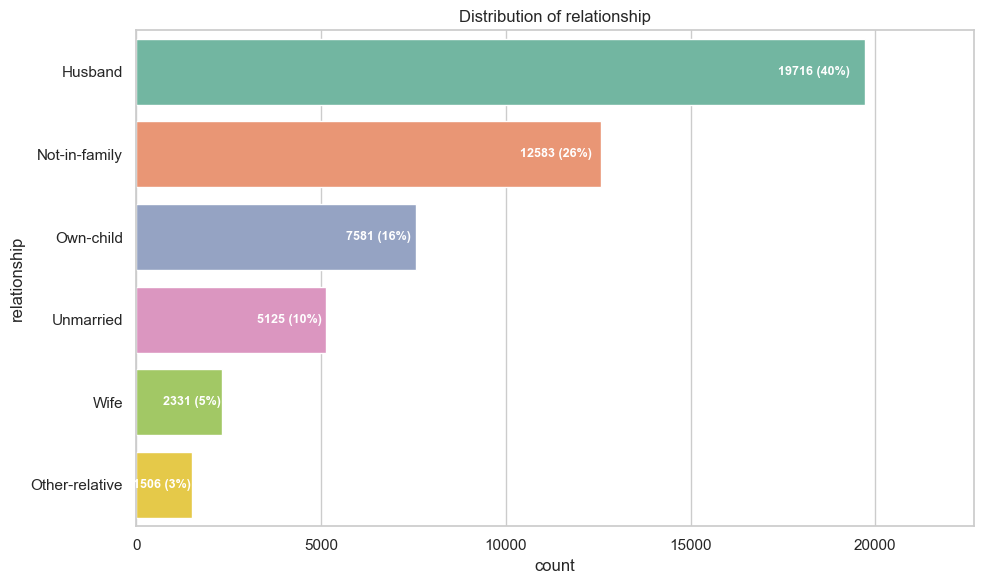

In [139]:
plt.figure(figsize=(10,6))
ax = sns.countplot(
    data=df_train_test,
    y=col,
    order=counts.index,
    palette="Set2"   # adds color
)
plt.title("Distribution of relationship")

# Expand x‑axis so labels fit
plt.xlim(0, max_count * 1.15)

# Add count + percentage labels INSIDE the bars
for p in ax.patches:
    count = int(p.get_width())
    percent = (count / total) * 100

    ax.annotate(
        f'{count} ({percent:.0f}%)',
        (count * 0.98, p.get_y() + p.get_height() / 2),
        ha='right', va='center',
        color='white', fontsize=9, fontweight='bold'
    )

plt.tight_layout()
plt.show()


#### The dataset is strong male- headed household signal with husband as the largest catgory(40%). 'Not-in-family is another major category with 26%. This variable is highly imbalanced.So for anlaysis or modeling, have to combine small categories and can explore interactions with marital status or sex

#### Race

In [141]:
col = "race"

counts = df_train_test[col].value_counts()
total = len(df_train_test[col])

print(counts)
print("\nProportions:")
print(df_train_test[col].value_counts(normalize=True))


race
White                 41762
Black                  4685
Asian-Pac-Islander     1519
Amer-Indian-Eskimo      470
Other                   406
Name: count, dtype: int64

Proportions:
race
White                 0.855043
Black                 0.095922
Asian-Pac-Islander    0.031100
Amer-Indian-Eskimo    0.009623
Other                 0.008313
Name: proportion, dtype: float64


#### The dataset contains five race categories, and the distribution is heavily dominated by one group with White 86% followed by Black with 10%

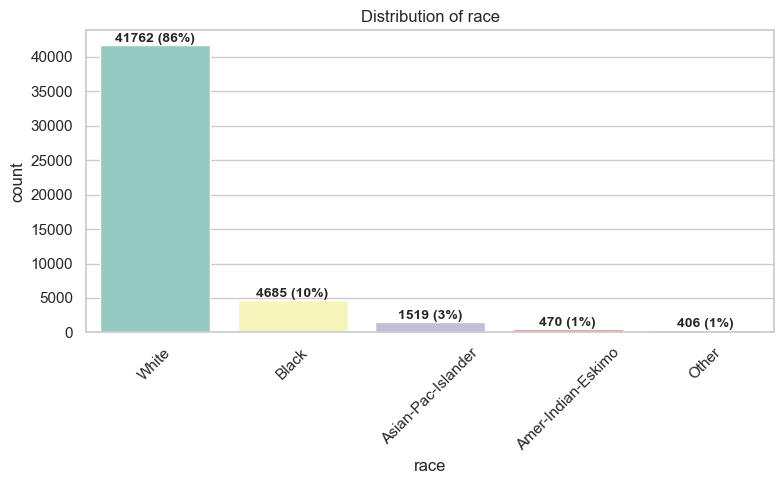

In [143]:
plt.figure(figsize=(8,5))
ax = sns.countplot(
    data=df_train_test,
    x=col,
    order=counts.index,
    palette="Set3"   #  color palette
)
plt.title("Distribution of race")
plt.xticks(rotation=45)

# Add count + percentage labels above bars
for p in ax.patches:
    count = int(p.get_height())
    percent = (count / total) * 100

    ax.annotate(
        f'{count} ({percent:.0f}%)',
        (p.get_x() + p.get_width() / 2, count),
        ha='center', va='bottom',
        fontsize=10, fontweight='bold'
    )

plt.tight_layout()
plt.show()

### White individuals make up over 86%. and this will storngly influence any analysis involving race.Black individuals represent 10%, making them the only sizable minority group in the dataset. Small but distinct groups such as Asian-Pac-Islander, Amer-Indian-Eskimo and Other may need careful handling in modeling and can be combined depending on the analysis.

# Target Variable : Income Analysis

In [145]:
# Frequency count
income_counts = df_train_test['income'].value_counts()

print("Frequency Distribution:")
print(income_counts)

Frequency Distribution:
income
<=50K    37155
>50K     11687
Name: count, dtype: int64


In [147]:
income_percent = df_train_test['income'].value_counts(normalize=True) * 100

print("Percentage Distribution:")
print(income_percent.round(2))

Percentage Distribution:
income
<=50K    76.07
>50K     23.93
Name: proportion, dtype: float64


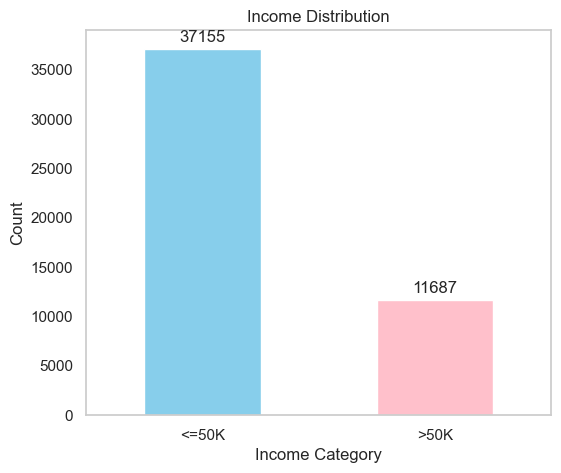

In [149]:
plt.figure(figsize=(6,5))

ax = income_counts.plot(kind='bar', color=['skyblue','pink'])

plt.title("Income Distribution")
plt.xlabel("Income Category")
plt.ylabel("Count")
plt.xticks(rotation=0)
plt.grid(False)

# Add labels on top
for container in ax.containers:
    ax.bar_label(container, fmt='%d', padding=3)

plt.show()

<span style="color: blue;">The income variable is imbalanced, with approximately 37,000 individuals earning ≤50K and around 11,700 earning >50K, showing a clear majority in the lower income category.</span>

<p style="font-family: Cambria;text-align: center;font-size:38px;"><b> FINAL CONCLUSION OF BIVARIATE ANALYSIS

The dataset shows distinct patterns across key features:  
- 'Age':  Most individuals fall in the working‑age range, with age concentrated around the mid‑30s and gradually declining in higher ages.

- Workclass: Most individuals belong to the private sector, with all other workclass categories making up only small portions of the population.

- Fnlwgt: The fnlwgt variable is heavily right‑skewed, with most values in the mid‑range and a small number of extremely large weights creating significant high‑end outliers.

- Education: Most individuals fall into mid‑level education categories, with High‑School being the most common and Associates the least represented.

- Education_num: Most individuals fall into mid‑level education categories, with High‑School being the most common and Associates the least frequent.
- `native-country` is highly imbalanced, dominated by individuals from the United-States, with many rare countries representing less than 1% each.  

- Numerical variables `capital-gain` and `capital-loss` are heavily right-skewed with most values at zero, indicating many individuals report no capital gains or losses.  
- `hours-per-week` centers around 40 hours with a roughly symmetric distribution, reflecting typical full-time work hours.

- 'Marital status': 'Married-civ-spouse dominates the dataset, making up to nearly half of all individuals.

- 'Occupation': Three occupations(Prof-specialty, Craft-repair, Exec-managerial) form a balanced top tier, while several categories form a long tail.

- 'Sex': The dataset is male‑dominant, with males representing about two‑thirds of the population

- 'Relationship': Husband is the largest relationship category, indicating a strong male‑headed household pattern.

- 'Race': White individuals overwhelmingly dominate the dataset, accounting for more than 85% of the population.

- The `income` variable is moderately imbalanced, with about 76% earning ≤50K and 24% earning >50K.  

In [155]:
print (df_train_test)

       age         workclass  fnlwgt  education  education-num  \
0       39         State-gov   77516  Bachelors             13   
1       50  Self-emp-not-inc   83311  Bachelors             13   
2       38           Private  215646    HS-grad              9   
3       53           Private  234721       11th              7   
4       28           Private  338409  Bachelors             13   
...    ...               ...     ...        ...            ...   
48837   39           Private  215419  Bachelors             13   
48838   64           Private  321403    HS-grad              9   
48839   38           Private  374983  Bachelors             13   
48840   44           Private   83891  Bachelors             13   
48841   35      Self-emp-inc  182148  Bachelors             13   

           marital-status         occupation    relationship  \
0           Never-married       Adm-clerical   Not-in-family   
1      Married-civ-spouse    Exec-managerial         Husband   
2              

In [157]:
df_train_test.head()

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,...,hours-per-week,native-country,income,income_num,age_group,workclass_grouped,fnlwgt_group,education_grouped,education_num_grouped,occupation_cluster
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,...,40,United-States,<=50K,0,31-40,Government,0-100K,Bachelors,Bachelors,Admin/Sales/Service
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,...,13,United-States,<=50K,0,41-50,Self-Employed,0-100K,Bachelors,Bachelors,Professional/Managerial
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,...,40,United-States,<=50K,0,31-40,Private,200K-300K,High-School,High-School,Skilled/Manual
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,...,40,United-States,<=50K,0,51-60,Private,200K-300K,Lower-Education,Lower-Education,Skilled/Manual
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,...,40,Cuba,<=50K,0,21-30,Private,300K-400K,Bachelors,Bachelors,Professional/Managerial


In [159]:
# Save cleaned dataset to CSV
df_train_test.to_csv('/Users/akhilamaheedhara/Downloads/train_test_adult.csv', index=False)

print("Cleaned dataset saved successfully!")


Cleaned dataset saved successfully!
